# DSCI-631-900 Project Proposal
### Fall 2023
### Team Member(s): Alec Peterson
### Email: ap3842@drexel.edu
### Team Number: 03

# Setup

### Data Imported from: https://www.kaggle.com/datasets/zynicide/wine-reviews

In [1]:
# Data processing
import pandas as pd
import pyarrow # Optional - use to read/write from .parquet files
import numpy as np

# Visualizations
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px # use for interactive graphs

import regex as re

# Import downloaded data
df = pd.read_csv("./data/wine_reviews/winemag-data-130k-v2.csv")
df = df.iloc[:, 1:]
df.head()

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks


# Dataset Analysis and Notes (Carryover from Proposal)

### High-level info

In [2]:
df.shape

(129971, 13)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129971 entries, 0 to 129970
Data columns (total 13 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   country                129908 non-null  object 
 1   description            129971 non-null  object 
 2   designation            92506 non-null   object 
 3   points                 129971 non-null  int64  
 4   price                  120975 non-null  float64
 5   province               129908 non-null  object 
 6   region_1               108724 non-null  object 
 7   region_2               50511 non-null   object 
 8   taster_name            103727 non-null  object 
 9   taster_twitter_handle  98758 non-null   object 
 10  title                  129971 non-null  object 
 11  variety                129970 non-null  object 
 12  winery                 129971 non-null  object 
dtypes: float64(1), int64(1), object(11)
memory usage: 12.9+ MB


#### **Description of columns**
0) `country` - country wine is from
1) `description` - text description from review
2) `designation` - vinyeard within the winerey where the grapes that made the wine are from
3) `points` - the number of points WineEnthusiast rated the wine on a scale of 1-100
4) `price` - cost of the bottle of wine
5) `province` - province or state that the wine is from
6) `region_1` - wine growing area in province or state
7) `region_2` - sometimes there are more specific regions within a wine growing area
8) `taster_name` - name of reviewer
9) `taster_twitter_handle` - taster's Twitter handle
10) `title` - title of wine review
11) `variety` - wine type or grape variety
12) `winery` - winery where wine was made

Notably:
* `designation`, `region_1`, and `taster_name` have a fair number of null values (~16 - 25%)
* `region_2` has more than half the values as null - not every wine review has a second region associated with it
* `taster_twitter_handle` - Not every taster has a twitter handle (presumably)

### Analysis of `country`

#### `make_count_df()` - turn Series.value_counts() into a dataframe for easier graphing

In [4]:
def make_count_df(df, colname):
    count_df = pd.DataFrame(df[colname].value_counts()).reset_index().rename(columns={colname:"count", "index":colname})
    
    return count_df

In [5]:
df_country_counts = make_count_df(df, "country")
df_country_counts.head()

,country,count
0,US,54504
1,France,22093
2,Italy,19540
3,Spain,6645
4,Portugal,5691


#### `make_count_perc_df()` - proportion of count for each group, specifying a bucket for those below lower limit

In [6]:
def make_count_perc_df(df, colname, lower_lim):
    count_df = make_count_df(df, colname)
    
    count_df = count_df.assign(count_cat = lambda x: np.where(x["count"] > lower_lim, x[colname], f"{colname.capitalize()} with <{lower_lim}"),
                               count_perc = lambda x: (x["count"] / x["count"].sum()) * 100
                              )
    
    count_df_agg = count_df.groupby("count_cat").agg("sum").reset_index().sort_values("count_perc", ascending=False)
    
    return count_df_agg

In [7]:
df_country_agg = make_count_perc_df(df, "country", 1000)
df_country_agg

,count_cat,count,count_perc
12,US,54504,41.955846
5,France,22093,17.006651
7,Italy,19540,15.041414
11,Spain,6645,5.115158
9,Portugal,5691,4.380793
3,Chile,4472,3.442436
0,Argentina,3800,2.925147
2,Austria,3345,2.574899
4,Country with <1000,2504,1.927518
1,Australia,2329,1.792807


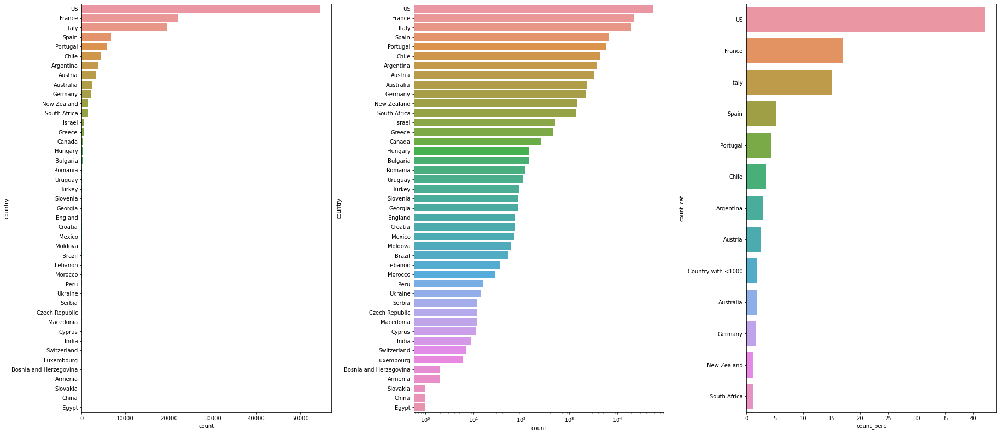

In [8]:
fig, axes = plt.subplots(1,3, figsize=(27, 14))
fig.tight_layout(pad=12)
a = sns.barplot(ax=axes[0], data = df_country_counts, x="count", y="country");
b = sns.barplot(ax=axes[1], data = df_country_counts, x="count", y="country");
c = sns.barplot(ax=axes[2], data = df_country_agg, x="count_perc", y ="count_cat");
axes[1].set(xscale="log");

* Most wines from US, France, Italy (account for ~75% of reviews)
* Less (but still many, in the 100s - 1000s) from Spain, Portugal, Chile... Seems to drop off after South Africa.

### Analysis of `province`

In [9]:
df["province"].value_counts()

California        36247
Washington         8639
Bordeaux           5941
Tuscany            5897
Oregon             5373
                  ...  
Messinia              1
Markopoulo            1
Paardeberg            1
Krania Olympus        1
Neuchâtel             1
Name: province, Length: 425, dtype: int64

In [10]:
df_province_counts_agg = make_count_perc_df(df, "province", 500)
df_province_counts_agg

,count_cat,count,count_perc
6,California,36247,27.902054
31,Province with <500,15328,11.799119
41,Washington,8639,6.650091
3,Bordeaux,5941,4.573236
38,Tuscany,5897,4.539366
26,Oregon,5373,4.136004
5,Burgundy,3980,3.063707
25,Northern Spain,3851,2.964406
28,Piedmont,3729,2.870493
20,Mendoza Province,3264,2.512547


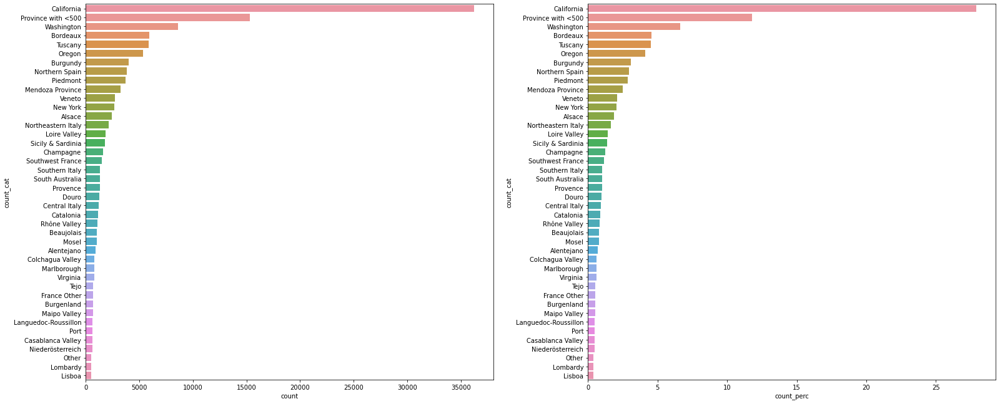

In [11]:
fig, axes = plt.subplots(1,2, figsize=(24, 12))
fig.tight_layout(pad=12)
sns.barplot(ax=axes[0], data = df_province_counts_agg, x="count", y="count_cat");
sns.barplot(ax=axes[1], data = df_province_counts_agg, x="count_perc", y="count_cat");

* Seems like California accounts for the most with > 25% of wines reviewed coming from that province
* Other specific regions like Washington, Bordeaux, Tuscany, Oregon, Burgundy....represent others but all at 3 to 6.6% each.
* Other regions account for even less, and bucketing provinces with < 500 wines - that accounts for ~ 12%.

### Analysis of `region_1`

In [12]:
df_reg1_counts = make_count_df(df, "region_1")
df_reg1_counts

,region_1,count
0,Napa Valley,4480
1,Columbia Valley (WA),4124
2,Russian River Valley,3091
3,California,2629
4,Paso Robles,2350
...,...,...
1224,Lamezia,1
1225,Trentino Superiore,1
1226,Grave del Friuli,1
1227,Vin Santo di Carmignano,1


In [13]:
df_reg1_counts[df_reg1_counts["count"]>10]

,region_1,count
0,Napa Valley,4480
1,Columbia Valley (WA),4124
2,Russian River Valley,3091
3,California,2629
4,Paso Robles,2350
...,...,...
628,La Rioja,11
629,Mâcon-Fuissé,11
630,Uclés,11
631,Erice,11


In [14]:
df_reg1_counts[df_reg1_counts["count"]>100]

,region_1,count
0,Napa Valley,4480
1,Columbia Valley (WA),4124
2,Russian River Valley,3091
3,California,2629
4,Paso Robles,2350
...,...,...
201,Santa Clara Valley,104
202,Venezia Giulia,104
203,Greco di Tufo,103
204,Côtes de Bourg,101


In [15]:
df_reg1_counts[df_reg1_counts["count"]>1000]

,region_1,count
0,Napa Valley,4480
1,Columbia Valley (WA),4124
2,Russian River Valley,3091
3,California,2629
4,Paso Robles,2350
5,Mendoza,2301
6,Willamette Valley,2301
7,Alsace,2163
8,Champagne,1613
9,Barolo,1599


* Only about half (~ 600+) of distinct `region_1` wines have more than 10 wines reviewed
* Only ~ 1/6 (~200) have more than 100 wines reviewed
* 18 regions have more than 1000 wine reviews
    * Many of these are from California, Washington, France, Italy...

### Analysis of `region_2`

In [16]:
df_reg2_counts_agg = make_count_perc_df(df, "region_2",0)
df_reg2_counts_agg

,count_cat,count,count_perc
1,Central Coast,11065,21.906119
12,Sonoma,9028,17.873335
3,Columbia Valley,8103,16.042050
6,Napa,6814,13.490131
16,Willamette Valley,3423,6.776742
0,California Other,2663,5.272119
4,Finger Lakes,1777,3.518046
11,Sierra Foothills,1462,2.894419
7,Napa-Sonoma,1169,2.314347
2,Central Valley,1062,2.102512


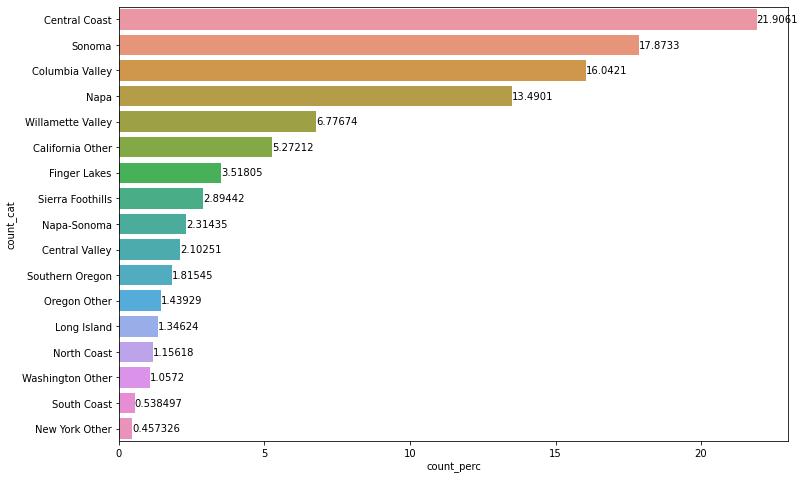

In [17]:
fig = plt.figure(figsize=(12,8))
ax = sns.barplot(data = df_reg2_counts_agg, x="count_perc", y ="count_cat");
for i in ax.containers:
    ax.bar_label(i,)

In [18]:
df[~(df["region_2"].isnull())]["region_1"].value_counts()

Napa Valley                               4480
Columbia Valley (WA)                      4124
Russian River Valley                      3091
California                                2629
Paso Robles                               2350
                                          ... 
Mendocino-Amador                             1
Sonoma-Napa-Mendocino                        1
Napa Valley-Paso Robles                      1
Monterey-San Luis Obispo-Santa Barbara       1
Sonoma County-Santa Barbara County           1
Name: region_1, Length: 202, dtype: int64

In [19]:
df[~(df["region_2"].isnull())]["region_1"].value_counts().shape[0] / len(df["region_1"].unique()) * 100 # percent of region_1s that have a region_2

16.422764227642276

In [20]:
df[~(df["region_2"].isnull())]["country"].value_counts()

US    50511
Name: country, dtype: int64

* From the names, most of the `region_2` names seem to come from a specific area within the United States
    * In California like Sonoma, Napa, Sierra Foothills, California Other
    * In New York like Finger Lakes, Long Island, New York Other
* Only 16.4% of entries `region_1` have a `region_2` listed - this may make it tough to use since it is not accounted for across the dataset
* Overall, the location information (country -> province -> region_1 -> region_2) could be concatenated in different ways to make an interesting feature

### Analysis of `price`

In [3]:
df["price"].describe()

count    120975.000000
mean         35.363389
std          41.022218
min           4.000000
25%          17.000000
50%          25.000000
75%          42.000000
max        3300.000000
Name: price, dtype: float64

In [7]:
df[df["price"] < 100].shape[0] / len(df)

0.9003854706049811

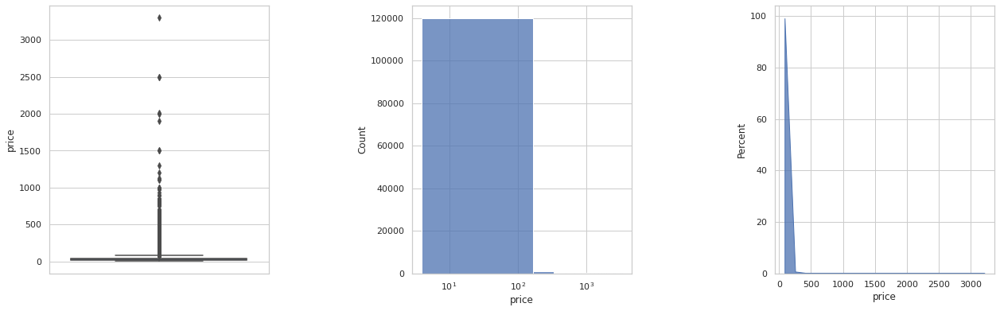

In [22]:
%matplotlib inline
sns.set_theme(style="whitegrid")

fig, axes = plt.subplots(1,3, figsize=(21, 9))
fig.tight_layout(pad=12)
sns.boxplot(ax=axes[0], data = df, y="price");
sns.histplot(ax=axes[1], data = df, x="price", bins=20, element="bars");
sns.histplot(ax=axes[2], data = df, x="price", bins=20, element="poly", stat="percent");
axes[1].set(xscale="log");

* Wine prices range from 4 to 3300 dollars
* 75% of wines are under 42 dollars or under
* Most reviews between 4 and a few hundred dollars

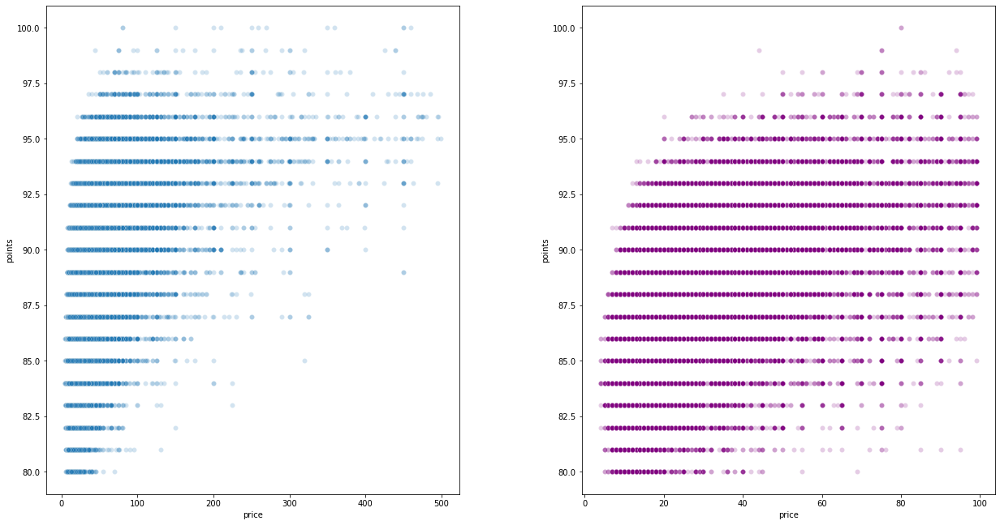

In [8]:
price_500_less = df[df["price"]<500] # filtering to < $500
price_100_less = df[df["price"]<100] # filtering to < $100

fig, axes = plt.subplots(1,2, figsize=(20, 12))
fig.tight_layout(pad=12)
sns.scatterplot(ax=axes[0], data = price_500_less, x="price", y="points", alpha=0.2);
sns.scatterplot(ax=axes[1], data = price_100_less, x="price", y="points", color="purple", alpha=0.2);

In [12]:
px.scatter(price_100_less,
           x="price",
           y="points",
           template="plotly_white",
           opacity=0.7
           width=600,
           height=400
          )

SyntaxError: invalid syntax (<ipython-input-12-205a3ec55d1e>, line 6)

In [24]:
df.corr()

,points,price
points,1.000000,0.416167
price,0.416167,1.000000


In [25]:
price_500_less.corr()

,points,price
points,1.000000,0.499197
price,0.499197,1.000000


In [26]:
price_100_less.corr()

,points,price
points,1.000000,0.547068
price,0.547068,1.000000


* There is a significant correlation between `points` and `price` however there are values on the lower end of price
* This relationship is stronger for a lower range of prices
    * R2 = 0.42 for up whole dataset (up to ~3300 dollars)
    * R2 = 0.50 for up to 500 dollars
    * R2 = 0.55 for up to 100 dollars
* Perhaps price could be made into different categories e.g. (0-20, 20-40, 40-60, 60-100, 100-500, >500)
* Data could be stratified based on price as there is a strong relationship between price and score!

### Analysis of `designation`

In [27]:
make_count_df(df, "designation") # too many to graph

,designation,count
0,Reserve,2009
1,Estate,1322
2,Reserva,1259
3,Riserva,698
4,Estate Grown,621
...,...,...
37974,Ilercavònia,1
37975,VA,1
37976,Sein,1
37977,Vigna Riserva,1


In [28]:
make_count_perc_df(df, "designation", 100)

,count_cat,count,count_perc
8,Designation with <100,81417,88.012669
19,Reserve,2009,2.171751
10,Estate,1322,1.429096
18,Reserva,1259,1.360993
20,Riserva,698,0.754546
12,Estate Grown,621,0.671308
4,Brut,513,0.554559
9,Dry,413,0.446458
2,Barrel sample,375,0.405379
7,Crianza,343,0.370787


* Many individual types of `designation` (~ 37k)
* While some `designation` have counts from 100 to 2000, they account for a very small percentage of the dataset
* Unclear what the difference or connotation of these should be

### Analysis of `taster_name` and `taster_witter_handle`

In [29]:
taster_name_count = make_count_df(df, "taster_name")
taster_name_count

,taster_name,count
0,Roger Voss,25514
1,Michael Schachner,15134
2,Kerin O’Keefe,10776
3,Virginie Boone,9537
4,Paul Gregutt,9532
5,Matt Kettmann,6332
6,Joe Czerwinski,5147
7,Sean P. Sullivan,4966
8,Anna Lee C. Iijima,4415
9,Jim Gordon,4177


In [30]:
taster_name_count_agg = make_count_perc_df(df, "taster_name", 0)
taster_name_count_agg = taster_name_count_agg.rename(columns={"count_cat": "taster_name"})
taster_name_count_agg

,taster_name,count,count_perc
15,Roger Voss,25514,24.597260
12,Michael Schachner,15134,14.590222
9,Kerin O’Keefe,10776,10.388809
18,Virginie Boone,9537,9.194327
14,Paul Gregutt,9532,9.189507
11,Matt Kettmann,6332,6.104486
8,Joe Czerwinski,5147,4.962064
16,Sean P. Sullivan,4966,4.787567
1,Anna Lee C. Iijima,4415,4.256365
7,Jim Gordon,4177,4.026917


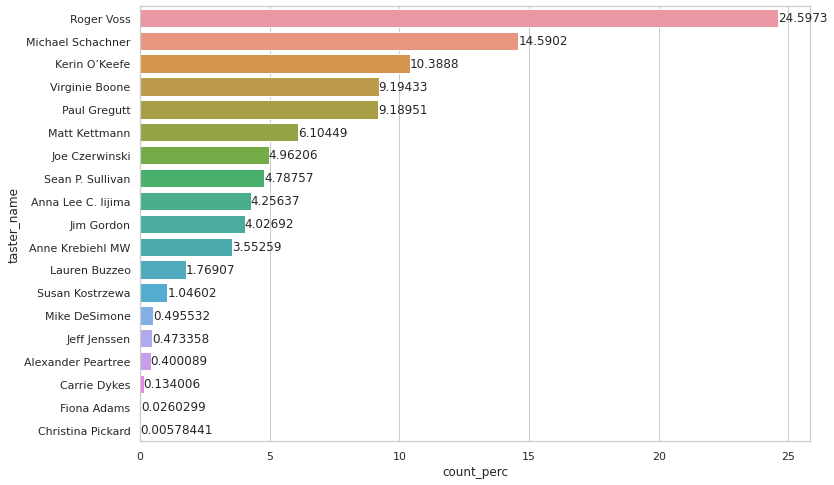

In [31]:
fig = plt.figure(figsize=(12,8))
ax = sns.barplot(data = taster_name_count_agg, x="count_perc", y ="taster_name");
for i in ax.containers:
    ax.bar_label(i,)

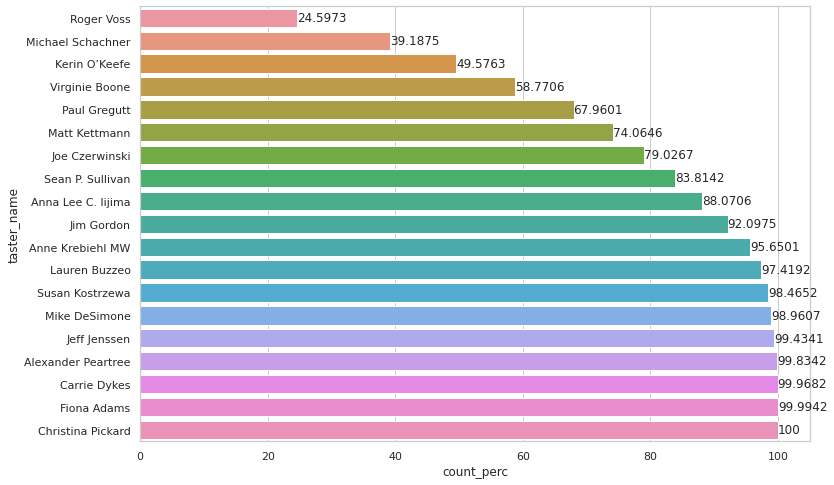

In [32]:
# CUMULATIVE proportion of reviews
import matplotlib
taster_name_count_cumul = taster_name_count_agg.cumsum()
taster_name_count_cumul["taster_name"] = taster_name_count_agg["taster_name"]
fig = plt.figure(figsize=(12,8))
ax = sns.barplot(data = taster_name_count_cumul, x="count_perc", y ="taster_name");
for i in ax.containers:
    ax.bar_label(i,)

font = {'family' : 'DejaVu Sans',
        'size'   : 12}

plt.rc("axes", labelsize=12)

* Nearly 1/4 of reviews with a taster listed (~100k of ~130k) are done by Roger Voss!
* Over 2/3 of reviews with a taster are done by Roger Voss, Michael Schachner, Kerin O'Keefe, Virginie Boone, or Paul Gregutt
* The opinions expressed (presumably by the taster) in `description` may be biased. This is likely an important categorical feature to take into account as it could relate to sentiments or specific tastes

In [33]:
make_count_df(df, "taster_twitter_handle")

,taster_twitter_handle,count
0,@vossroger,25514
1,@wineschach,15134
2,@kerinokeefe,10776
3,@vboone,9537
4,@paulgwine,9532
5,@mattkettmann,6332
6,@JoeCz,5147
7,@wawinereport,4966
8,@gordone_cellars,4177
9,@AnneInVino,3685


* Not all reviewers have a twitter handle

### Analysis of `title`

In [34]:
df["title"].value_counts()

Gloria Ferrer NV Sonoma Brut Sparkling (Sonoma County)                         11
Korbel NV Brut Sparkling (California)                                           9
Segura Viudas NV Extra Dry Sparkling (Cava)                                     8
Ruinart NV Brut Rosé  (Champagne)                                               7
Segura Viudas NV Aria Estate Extra Dry Sparkling (Cava)                         7
                                                                               ..
Cave de Tain 2009 Gambert de Loche  (Hermitage)                                 1
Les Vins de Vienne 2009 Les Barcillants  (Cornas)                               1
Jean-Luc Colombo 2009 La Louvée  (Cornas)                                       1
Jean-Luc Baldès 2009 Clos Triguedina The New Black Wine Malbec (Cahors)         1
Domaine Schoffit 2012 Lieu-dit Harth Cuvée Caroline Gewurztraminer (Alsace)     1
Name: title, Length: 118840, dtype: int64

In [35]:
df["title"].sample(20)

74550                         CARM 2005 Reserva Red (Douro)
89189     Carlisle 2014 Steiner Vineyard Grüner Veltline...
49705     Hirsch 2013 Lamm Reserve Grüner Veltliner (Kam...
17906         Kirkland Signature 2011 Meritage (Rutherford)
111568    Bodegas Ramon Ramos 2011 Monte Toro Crianza  (...
102424                Travaglini 2009 Il Sogno  (Gattinara)
104697       Chandon NV Brut Classic Sparkling (California)
111445        D'Anbino 2007 Orchestration Red (Paso Robles)
88428                 CVNE 2012 Pagos de Viña Real  (Rioja)
23139      Sottano 2010 Reserva de Familia Malbec (Mendoza)
11896     William Hill Estate 2013 Benchland Series Malb...
5090      Robert Mondavi 2011 Private Selection Meritage...
124062    Saracina 2014 Skid Row Vineyard Malbec (Mendoc...
7490      Vivác Winery 2005 V. Single Vineyard Nebbiolo ...
105740    Château Lafon-Rochet 2009 Barrel sample  (Sain...
14571        Baglio di Pianetto 2015 Timeo Grillo (Sicilia)
42099                 Gerald Talmard 201

* 118840 unique wine review titles
    * most reviews with the same name is 11
* "Sparkling" is an important thing to note about the wine type like "red" and "white" (though I think these would nearly be a subvariety of "white" or "rose")
    * Would likely contain specific notes present in the description
* Year is often mentioned - the age of the wine might be interesting, but would need to know that relative to when the review was made.
* Overall - Seems to overlap with information from the other columns

### Analysis of `variety`

In [2]:
df["variety"].value_counts()

Pinot Noir                    13272
Chardonnay                    11753
Cabernet Sauvignon             9472
Red Blend                      8946
Bordeaux-style Red Blend       6915
                              ...  
Cabernet Sauvignon-Barbera        1
Sauvignonasse                     1
Forcallà                          1
Meseguera                         1
Bobal-Cabernet Sauvignon          1
Name: variety, Length: 707, dtype: int64

In [3]:
len(df["variety"].unique())

708

In [12]:
foo = df["variety"].value_counts()
foo[foo>20]

Pinot Noir                           13272
Chardonnay                           11753
Cabernet Sauvignon                    9472
Red Blend                             8946
Bordeaux-style Red Blend              6915
                                     ...  
Tocai Friulano                          22
Monastrell-Syrah                        21
Xarel-lo                                21
Cabernet Merlot                         21
Cabernet Sauvignon-Cabernet Franc       21
Name: variety, Length: 209, dtype: int64

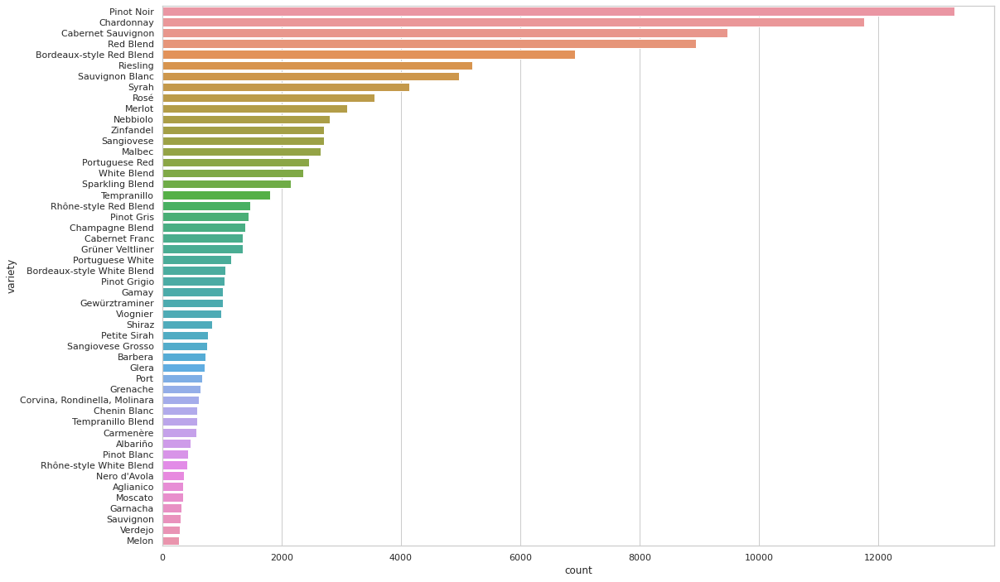

In [36]:
%matplotlib inline
sns.set_theme(style="whitegrid")

df_variety_counts = make_count_df(df, "variety")[:50]

fig = plt.figure(figsize=(18, 12))
sns.barplot(data = df_variety_counts, x="count", y="variety");

* Both red wines and white wines seem to be represented.
* One feature (requiring external data e.g. from a list or table of grapes and wines) would be to categorize as White, Red, Rose (or other...)
    * Could be used in conjunction with words used in the `description`...

### Analysis of `winery`

In [37]:
df["winery"].value_counts()

Wines & Winemakers    222
Testarossa            218
DFJ Vinhos            215
Williams Selyem       211
Louis Latour          199
                     ... 
Hypothesis              1
Camps d'Estels          1
Harbor Town             1
Château de Saurs        1
Penedo Borges           1
Name: winery, Length: 16757, dtype: int64

In [38]:
df["winery"].value_counts().head(50).cumsum()

Wines & Winemakers             222
Testarossa                     440
DFJ Vinhos                     655
Williams Selyem                866
Louis Latour                  1065
Georges Duboeuf               1261
Chateau Ste. Michelle         1455
Concha y Toro                 1619
Columbia Crest                1778
Kendall-Jackson               1908
Siduri                        2034
Gary Farrell                  2159
Lynmar                        2277
Montes                        2394
Albert Bichot                 2511
Jean-Luc and Paul Aegerter    2624
Trapiche                      2737
Casa Santos Lima              2850
Undurraga                     2963
Santa Ema                     3075
Robert Mondavi                3187
Chanson Père et Fils          3296
Fess Parker                   3404
V. Sattui                     3511
Iron Horse                    3617
Foxen                         3722
Louis Jadot                   3826
Feudi di San Gregorio         3928
Maryhill            

In [39]:
winery_count = pd.DataFrame(df["winery"].value_counts()).reset_index().rename(columns={"index": "winery", "winery": "count"})
single_review_winery_count = winery_count[winery_count['count']==1].shape[0]
print(f"Number of wineries with only one (1) wine review: {single_review_winery_count} ")
print(f"This represents {(single_review_winery_count / len(df['winery'].unique()) * 100):.1f} % of the wineries")

Number of wineries with only one (1) wine review: 4240 
This represents 25.3 % of the wineries


* About a quarter of the wineries have one-off reviews!

### Analysis of `points` - the label to be used for regression task

In [40]:
df["points"].describe()

count    129971.000000
mean         88.447138
std           3.039730
min          80.000000
25%          86.000000
50%          88.000000
75%          91.000000
max         100.000000
Name: points, dtype: float64

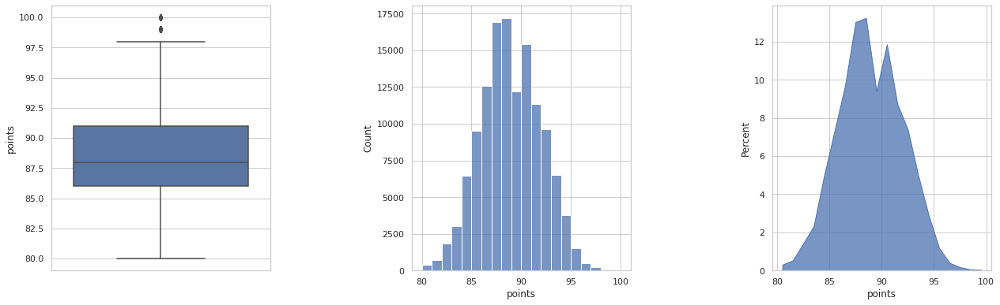

In [41]:
%matplotlib inline
sns.set_theme(style="whitegrid")

fig, axes = plt.subplots(1,3, figsize=(21, 9))
fig.tight_layout(pad=12)
sns.boxplot(ax=axes[0], data = df, y="points");
sns.histplot(ax=axes[1], data = df, x="points", bins=20, element="bars");
sns.histplot(ax=axes[2], data = df, x="points", bins=20, element="poly", stat="percent");

* Scores range from 80 to 100
* A couple outliers at 98 and 100...but most of the scores range from 85 to 94 (eyeballing)
* Seems relatively normally distributed / no significant skewing

### Compiled Observations

* High-level notes on dataset:
    * `designation`, `region_1`, and `taster_name` have a fair number of null values (~16 - 25%)
    * `region_2` has more than half the values as null - not every wine review has a second region associated with it
    * `taster_twitter_handle` - Not every taster has a twitter handle (presumably)

<br>

* `country`
    * Most wines from US, France, Italy (account for ~75% of reviews)
    * Less (but still many, in the 100s - 1000s) from Spain, Portugal, Chile... Seems to drop off after South Africa.


* `province`
    * Seems like California accounts for the most with > 25% of wines reviewed coming from that province
    * Other specific regions like Washington, Bordeaux, Tuscany, Oregon, Burgundy....represent others but all at 3 to 6.6% each.
    * Other regions account for even less, and bucketing provinces with < 500 wines - that accounts for ~ 12%.


* `region_1`
    * Only about half (~ 600+) of distinct `region_1` wines have more than 10 wines reviewed
    * Only ~ 1/6 (~200) have more than 100 wines reviewed
    * 18 regions have more than 1000 wine reviews
        * Many of these are from California, Washington, France, Italy...
    * `country` concatentated to`region_1` may be an interesting feature


* `region_2`
    * From the names, most of the `region_2` names seem to come from a specific area within the United States
        * In California like Sonoma, Napa, Sierra Foothills, California Other
        * In New York like Finger Lakes, Long Island, New York Other
    * Only 16.4% of entries `region_1` have a `region_2` listed - this may make it tough to use since it is not accounted for across the dataset
    * Overall, the location information (country -> province -> region_1 -> region_2) could be concatenated in different ways to make an interesting feature

* `price`
    * Wine prices range from 4 to 3300 dollars
    * 75% of wines are under 42 dollars or under
    * Most reviews between 4 and a few hundred dollars
    * There is a significant correlation between `points` and `price` however there are values on the lower end of price
    * This relationship is stronger for a lower range of prices
        * R2 = 0.42 for up whole dataset (up to ~3300 dollars)
        * R2 = 0.50 for up to 500 dollars
        * R2 = 0.55 for up to 100 dollars
    * Perhaps price could be made into different categories e.g. (0-20, 20-40, 40-60, 60-100, 100-500, >500)
    * Data could be stratified based on price as there is a strong relationship between price and score!


* `designation`
    * Many different unique designations (~37k) - unsure how this could be used to cluster, categorize, or differentiate


* `taster_name`
    * * Nearly 1/4 of reviews with a taster listed (~100k of ~130k) are done by Roger Voss!
    * Over 2/3 of reviews with a taster are done by Roger Voss, Michael Schachner, Kerin O'Keefe, Virginie Boone, or Paul Gregutt
    * The opinions expressed (presumably by the taster) in `description` may be biased. This is likely an important categorical feature to take into account as it could relate to sentiments or specific tastes


* `title`
    * 118840 unique wine review titles
        * most reviews with the same name is 11
    * "Sparkling" is an important thing to note about the wine type like "red" and "white" (though I think these would nearly be a subvariety of "white" or "rose")
        * Would likely contain specific notes present in the description
    * Year is often mentioned - the age of the wine might be interesting, but would need to know that relative to when the review was made.
    * Overall - Seems to overlap with information from the other columns


* `variety`
    * Both red wines and white wines seem to be represented.
    * One feature from this (requiring external data e.g. from a list or table of grapes and wines) would be to categorize as White, Red, Rose (or other...)
        * Could be used in conjunction with words used in the `description`...


* `winery`
    * Wineries have a range of 1 up to 200ish wineries
    * ~25% of the wineries have only 1 reviewed wine


* `points`
    * Scores range from 80 to 100
    * A couple outliers at 98 and 100...but most of the scores range from 85 to 94 (eyeballing)
    * Seems relatively normally distributed / no significant skewing
    
<br>

* `description` will require specific text analysis (see following section)

# NLP Features and Linear Regression Baseline

## Dataframe with list column of `description` lemmas

In [2]:
# Takes about ~5 minutes to run without GPU

import timeit
import spacy
spacy.prefer_gpu() # Runs twice as fast on GPU, but almost runs out of GPU memory!

length=len(df) # experiment by specifying shorter length

#### START TIMER ####
start_time = timeit.default_timer() # for timing

# 1) Parse stream of description strings into doc objects - nlp.pipe() more efficient method to use on list of strings
nlp = spacy.load("en_core_web_sm", disable=["tagger", "parser"]) # works faster only specific parts of pipeline needed are retained. Tagger and Parser are default unless disabled
descriptions = list(nlp.pipe(df["description"][:length]))

# 2) Make a dictionary that will be made into a DataFrame - each element is a list of lemmas
desc_dict = {}
for i in range(len(descriptions)):
    desc_dict[i] = [[token.lemma_ for token in descriptions[i]
                    if not token.is_stop and not token.is_punct and not token.is_space and not token.like_num # For some reason this retains year-likes
                   ]]

# 3) Make desc_dict into dataframe    
desc_lemmas = pd.DataFrame(desc_dict).transpose().rename(columns={0:"desc_lemmas"})

# 4) Concatentate onto df, then select only description, desc_lemmas, and points
df_desc = (pd.concat([df.iloc[:length,:], desc_lemmas], axis=1)
           .loc[:, ["description", "desc_lemmas", "points", "taster_name", "price"]]
          )


#### END TIMER ####
elapsed = timeit.default_timer() - start_time
print(f"Elapsed time: {elapsed/60: .2f} minutes")

/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/spacy/pipeline/lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)


Elapsed time:  2.16 minutes


In [3]:
df_desc

,description,desc_lemmas,points,taster_name,price
0,"Aromas include tropical fruit, broom, brimston...","[aromas, include, tropical, fruit, broom, brim...",87,Kerin O’Keefe,NaN
1,"This is ripe and fruity, a wine that is smooth...","[ripe, fruity, wine, smooth, structured, firm,...",87,Roger Voss,15.0
2,"Tart and snappy, the flavors of lime flesh and...","[tart, snappy, flavors, lime, flesh, rind, dom...",87,Paul Gregutt,14.0
3,"Pineapple rind, lemon pith and orange blossom ...","[pineapple, rind, lemon, pith, orange, blossom...",87,Alexander Peartree,13.0
4,"Much like the regular bottling from 2012, this...","[like, regular, bottling, comes, rough, tannic...",87,Paul Gregutt,65.0
...,...,...,...,...,...
129966,Notes of honeysuckle and cantaloupe sweeten th...,"[notes, honeysuckle, cantaloupe, sweeten, deli...",90,Anna Lee C. Iijima,28.0
129967,Citation is given as much as a decade of bottl...,"[citation, given, decade, bottle, age, prior, ...",90,Paul Gregutt,75.0
129968,Well-drained gravel soil gives this wine its c...,"[drained, gravel, soil, gives, wine, crisp, dr...",90,Roger Voss,30.0
129969,"A dry style of Pinot Gris, this is crisp with ...","[dry, style, pinot, gris, crisp, acidity, weig...",90,Roger Voss,32.0


## Classification via Lexicons

In [4]:
with open("./opinion_lexicon/positive-words.txt") as f:
    pos_words = [line.strip() for line in f.readlines()][35:]
    

pos_words[:10]

['a+',
 'abound',
 'abounds',
 'abundance',
 'abundant',
 'accessable',
 'accessible',
 'acclaim',
 'acclaimed',
 'acclamation']

In [5]:
with open("./opinion_lexicon/negative-words.txt") as f:
    neg_words = [line.strip() for line in f.readlines()][35:]

neg_words[:10]

['2-faced',
 '2-faces',
 'abnormal',
 'abolish',
 'abominable',
 'abominably',
 'abominate',
 'abomination',
 'abort',
 'aborted']

### `overlapping_count_list()`

In [6]:
def overlapping_count_list(series, word_list):
    overlapping_count = [len(set(series[i]).intersection(set(word_list))) for i in range(len(series))]
    
    return overlapping_count

In [7]:
def overlapping_proportion_list(series, word_list):
    overlapping_proportion = [(len(set(series[i]).intersection(set(word_list))) / len(series[i])) for i in range(len(series))]
    
    return overlapping_proportion

### Word count and proportion columns for positive and negative word lexicons

In [8]:
df_desc["pos_word_count"] = overlapping_count_list(df_desc["desc_lemmas"], pos_words)
df_desc["pos_word_prop"] = overlapping_proportion_list(df_desc["desc_lemmas"], pos_words)

df_desc["neg_word_count"] = overlapping_count_list(df_desc["desc_lemmas"], neg_words)
df_desc["neg_word_prop"] = overlapping_proportion_list(df_desc["desc_lemmas"], neg_words)
df_desc

,description,desc_lemmas,points,taster_name,price,pos_word_count,pos_word_prop,neg_word_count,neg_word_prop
0,"Aromas include tropical fruit, broom, brimston...","[aromas, include, tropical, fruit, broom, brim...",87,Kerin O’Keefe,NaN,1,0.050000,1,0.050000
1,"This is ripe and fruity, a wine that is smooth...","[ripe, fruity, wine, smooth, structured, firm,...",87,Roger Voss,15.0,2,0.117647,0,0.000000
2,"Tart and snappy, the flavors of lime flesh and...","[tart, snappy, flavors, lime, flesh, rind, dom...",87,Paul Gregutt,14.0,4,0.222222,0,0.000000
3,"Pineapple rind, lemon pith and orange blossom ...","[pineapple, rind, lemon, pith, orange, blossom...",87,Alexander Peartree,13.0,2,0.090909,1,0.045455
4,"Much like the regular bottling from 2012, this...","[like, regular, bottling, comes, rough, tannic...",87,Paul Gregutt,65.0,3,0.142857,2,0.095238
...,...,...,...,...,...,...,...,...,...
129966,Notes of honeysuckle and cantaloupe sweeten th...,"[notes, honeysuckle, cantaloupe, sweeten, deli...",90,Anna Lee C. Iijima,28.0,2,0.095238,0,0.000000
129967,Citation is given as much as a decade of bottl...,"[citation, given, decade, bottle, age, prior, ...",90,Paul Gregutt,75.0,2,0.083333,0,0.000000
129968,Well-drained gravel soil gives this wine its c...,"[drained, gravel, soil, gives, wine, crisp, dr...",90,Roger Voss,30.0,2,0.105263,2,0.105263
129969,"A dry style of Pinot Gris, this is crisp with ...","[dry, style, pinot, gris, crisp, acidity, weig...",90,Roger Voss,32.0,3,0.150000,0,0.000000


## Correlations to `points`

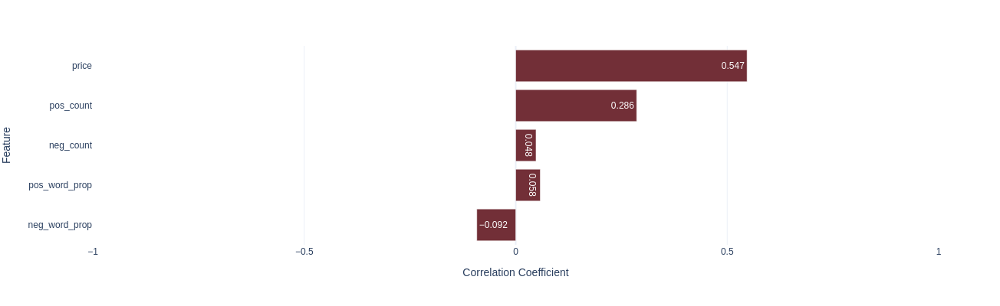

In [11]:
import plotly.express as px

pos_neg_corr_dict = {"Feature": ["price", "pos_count", "neg_count", "pos_word_prop", "neg_word_prop"],
                     "Correlation Coefficient": [0.547, 0.286, 0.048, 0.058, -0.092]
                    }

corr_df = pd.DataFrame(pos_neg_corr_dict)

px.bar(corr_df,
       y="Feature",
       x="Correlation Coefficient",
       range_x = [-1, 1],
       template="plotly_white",
       category_orders = {"Feature": ["price", "pos_count", "neg_count", "pos_word_prop", "neg_word_prop"]},
       color_discrete_sequence = ["#722F37"],
       width=600,
       height=400,
       text_auto=True
      )

## Baseline Performance - Linear Regression

### `df_input_baseline`

In [9]:
df_input_baseline = (df.copy()
            .loc[:, ["country", "price", "taster_name", "points", "description", "variety"]]
            .query("price < 100")
            .reset_index(drop=True)
           )
df_input_baseline

,country,price,taster_name,points,description,variety
0,Portugal,15.0,Roger Voss,87,"This is ripe and fruity, a wine that is smooth...",Portuguese Red
1,US,14.0,Paul Gregutt,87,"Tart and snappy, the flavors of lime flesh and...",Pinot Gris
2,US,13.0,Alexander Peartree,87,"Pineapple rind, lemon pith and orange blossom ...",Riesling
3,US,65.0,Paul Gregutt,87,"Much like the regular bottling from 2012, this...",Pinot Noir
4,Spain,15.0,Michael Schachner,87,Blackberry and raspberry aromas show a typical...,Tempranillo-Merlot
...,...,...,...,...,...,...
117019,Germany,28.0,Anna Lee C. Iijima,90,Notes of honeysuckle and cantaloupe sweeten th...,Riesling
117020,US,75.0,Paul Gregutt,90,Citation is given as much as a decade of bottl...,Pinot Noir
117021,France,30.0,Roger Voss,90,Well-drained gravel soil gives this wine its c...,Gewürztraminer
117022,France,32.0,Roger Voss,90,"A dry style of Pinot Gris, this is crisp with ...",Pinot Gris


### Remap `country` if count < 10

In [10]:
country_counts = df_input_baseline["country"].value_counts()
country_counts[country_counts < 10]

India                     9
Luxembourg                6
Switzerland               4
Bosnia and Herzegovina    2
Armenia                   2
Slovakia                  1
China                     1
Name: country, dtype: int64

In [11]:
low_count_countries = list(country_counts[country_counts < 10].index)
low_count_countries

['India',
 'Luxembourg',
 'Switzerland',
 'Bosnia and Herzegovina',
 'Armenia',
 'Slovakia',
 'China']

In [12]:
# Remap country if count is less than 10
df_input_baseline["country"] = (np.where(df_input_baseline["country"].isin(low_count_countries), 
                                         "Other", 
                                         df_input_baseline["country"])
                               )

df_input_baseline["country"].value_counts()

US                52949
France            16674
Italy             16143
Spain              6348
Portugal           4779
Chile              4372
Argentina          3656
Austria            2775
Australia          2183
Germany            2006
New Zealand        1365
South Africa       1280
Israel              485
Greece              461
Canada              253
Bulgaria            140
Hungary             139
Romania             118
Uruguay             107
Turkey               89
Georgia              84
Slovenia             80
Croatia              71
England              69
Mexico               68
Moldova              59
Brazil               47
Lebanon              35
Morocco              28
Other                25
Peru                 16
Ukraine              14
Czech Republic       12
Serbia               12
Macedonia            12
Cyprus               11
Name: country, dtype: int64

### Remap `variety` if count < 20

In [13]:
# Get value counts series
variety_counts = df_input_baseline["variety"].value_counts()

# List of varieties with count less than 20
low_count_varieties = list(variety_counts[variety_counts < 20].index)

# Remap variety column
df_input_baseline["variety"] = np.where(df_input_baseline["variety"].isin(low_count_varieties), "Other", df_input_baseline["variety"])

### `price_cat` - categorize `price` for stratification

In [14]:
df_input_baseline["price_cat"] = pd.cut(df_input_baseline["price"],
                                        bins=[0, 20, 40, 60, 80, 100],
                                        labels=["0-20", "20-40", "40-60", "60-80", "80-100"]
                                       )

### `pos_word_count` and `neg_word_prop` columns

In [16]:
df_input_baseline["pos_word_count"] = df_desc.query("price < 100")["pos_word_count"]

df_input_baseline["neg_word_prop"] = df_desc.query("price < 100")["neg_word_prop"]

df_input_baseline.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117024 entries, 0 to 117023
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   country         116965 non-null  object  
 1   price           117024 non-null  float64 
 2   taster_name     93377 non-null   object  
 3   points          117024 non-null  int64   
 4   description     117024 non-null  object  
 5   variety         117023 non-null  object  
 6   price_cat       117024 non-null  category
 7   pos_word_count  105398 non-null  float64 
 8   neg_word_prop   105398 non-null  float64 
dtypes: category(1), float64(3), int64(1), object(4)
memory usage: 7.3+ MB


### Split data

In [17]:
from sklearn.model_selection import train_test_split

strat_train_set_baseline, strat_test_set_baseline = train_test_split(df_input_baseline,
                                                                     test_size=0.2,
                                                                     random_state=42,
                                                                     stratify = df_input_baseline["price_cat"])

In [18]:
reviews_baseline = strat_train_set_baseline.drop("points", axis=1)
reviews_labels_baseline = strat_train_set_baseline["points"].copy()

In [19]:
reviews_baseline.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93619 entries, 45847 to 112606
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   country         93575 non-null  object  
 1   price           93619 non-null  float64 
 2   taster_name     74764 non-null  object  
 3   description     93619 non-null  object  
 4   variety         93618 non-null  object  
 5   price_cat       93619 non-null  category
 6   pos_word_count  84335 non-null  float64 
 7   neg_word_prop   84335 non-null  float64 
dtypes: category(1), float64(3), object(4)
memory usage: 5.8+ MB


### Pipeline

In [21]:
# 7) Build pipeline
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder


# Numerical pipeline
reviews_num_baseline = reviews_baseline.loc[:, ["price", "pos_word_count", "neg_word_prop"]]

num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('std_scaler', StandardScaler()),
    ])

## List numerical and categorical attributes
num_attribs = list(reviews_num_baseline)
cat_attribs = ["country", "taster_name", "variety"]

# Full pipeline
full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])

reviews_prepared_baseline = full_pipeline.fit_transform(reviews_baseline)
reviews_prepared_baseline

<93619x268 sparse matrix of type '<class 'numpy.float64'>'
	with 561714 stored elements in Compressed Sparse Row format>

### CV

In [23]:
from sklearn.linear_model import LinearRegression

lin_reg_baseline = LinearRegression()

from sklearn.model_selection import cross_val_score

# 10-fold cross-validation
scores_baseline = cross_val_score(lin_reg_baseline, 
                         reviews_prepared_baseline, 
                         reviews_labels_baseline,
                         scoring="neg_mean_squared_error",
                         n_jobs=4,
                         cv=10)
# convert to RMSE
lin_reg__baseline_scores = np.sqrt(-scores_baseline)

print(f"Baseline performance with Linear Regression and simple NLP features: {lin_reg__baseline_scores.mean(): .2f}")

Baseline performance with Linear Regression and simple NLP features:  2.31


#### **Error of ~2 points isn't terrible, but +/- 2 points for a range of 20 points (80 to 100) is not great**

# Hugging Face Transformer Features

In [25]:
df_input_baseline.to_parquet("df_input_baseline.parquet") # Export for use in Kaggle notebook for Transformers and GPU accelerators

In [27]:
pd.read_parquet("df_input_baseline.parquet")

,country,price,taster_name,points,description,variety,price_cat,pos_word_count,neg_word_prop
0,Portugal,15.0,Roger Voss,87,"This is ripe and fruity, a wine that is smooth...",Portuguese Red,0-20,NaN,NaN
1,US,14.0,Paul Gregutt,87,"Tart and snappy, the flavors of lime flesh and...",Pinot Gris,0-20,2.0,0.000000
2,US,13.0,Alexander Peartree,87,"Pineapple rind, lemon pith and orange blossom ...",Riesling,0-20,4.0,0.000000
3,US,65.0,Paul Gregutt,87,"Much like the regular bottling from 2012, this...",Pinot Noir,60-80,2.0,0.045455
4,Spain,15.0,Michael Schachner,87,Blackberry and raspberry aromas show a typical...,Other,0-20,3.0,0.095238
...,...,...,...,...,...,...,...,...,...
117019,Germany,28.0,Anna Lee C. Iijima,90,Notes of honeysuckle and cantaloupe sweeten th...,Riesling,20-40,2.0,0.125000
117020,US,75.0,Paul Gregutt,90,Citation is given as much as a decade of bottl...,Pinot Noir,60-80,1.0,0.142857
117021,France,30.0,Roger Voss,90,Well-drained gravel soil gives this wine its c...,Gewürztraminer,20-40,1.0,0.200000
117022,France,32.0,Roger Voss,90,"A dry style of Pinot Gris, this is crisp with ...",Pinot Gris,20-40,1.0,0.083333


## Kaggle Notebook Code
* See: "DSCI_631_G03_Project_Implementation_04Dec2022" Kaggle notebook
* Kaggle notebook used for GPU acceleration - output written to parquet files and imported into this local notebook

### distilbert_score_signed

In [ ]:
from transformers import pipeline
import tensorflow as tf

classifier_distilbert = pipeline("sentiment-analysis",
                      model="distilbert-base-uncased-finetuned-sst-2-english",
                      device=1
                     )

import timeit
start_time = timeit.default_timer() # for timing


sentiment_score = classifier_distilbert(df_input_baseline["description"].to_list(),
                             batch_size = 20
                            )


elapsed = timeit.default_timer() - start_time
print(f"Elapsed time: {(elapsed/60): .2f} minutes")

pd.DataFrame(sentiment_score)

In [ ]:
df_input = df_input_baseline.copy()
df_input

In [ ]:
df_input["distilBERT_score_signed"] = np.where(distilbert_score_df["label"] == "POSITIVE", distilbert_score_df["score"], -distilbert_score_df["score"])
df_input

### BERT num_stars

In [ ]:
from transformers import pipeline
# from tqdm.auto import tqdm

classifier_bert_stars = pipeline("sentiment-analysis",
                      model="nlptown/bert-base-multilingual-uncased-sentiment",
                      device=1
                     )

In [ ]:
import timeit
start_time = timeit.default_timer() # for timing


sentiment_score_outof5 = classifier_bert_stars(df_input["description"].to_list(),
                                               batch_size = 20
                                              )

#### END TIMER ####
elapsed = timeit.default_timer() - start_time
print(f"Elapsed time: {elapsed/60} minutes")

In [ ]:
num_stars_df = pd.DataFrame(sentiment_score_outof5)
num_stars_df

In [ ]:
df_input["num_stars"] = num_stars_df["label"].str.extract("(\d)").astype(int).to_numpy().flatten()
df_input

## Import Kaggle Notebook code

In [2]:
df_input = pd.read_parquet("df_input_with_transformers_features.parquet")
df_input

,country,price,taster_name,points,description,variety,price_cat,pos_word_count,neg_word_prop,distilBERT_score_signed,num_stars
0,Portugal,15.0,Roger Voss,87,"This is ripe and fruity, a wine that is smooth...",Portuguese Red,0-20,NaN,NaN,0.999641,4
1,US,14.0,Paul Gregutt,87,"Tart and snappy, the flavors of lime flesh and...",Pinot Gris,0-20,2.0,0.000000,0.995343,4
2,US,13.0,Alexander Peartree,87,"Pineapple rind, lemon pith and orange blossom ...",Riesling,0-20,4.0,0.000000,0.985368,3
3,US,65.0,Paul Gregutt,87,"Much like the regular bottling from 2012, this...",Pinot Noir,60-80,2.0,0.045455,0.999289,3
4,Spain,15.0,Michael Schachner,87,Blackberry and raspberry aromas show a typical...,Other,0-20,3.0,0.095238,0.999074,4
...,...,...,...,...,...,...,...,...,...,...,...
117019,Germany,28.0,Anna Lee C. Iijima,90,Notes of honeysuckle and cantaloupe sweeten th...,Riesling,20-40,2.0,0.125000,0.999781,5
117020,US,75.0,Paul Gregutt,90,Citation is given as much as a decade of bottl...,Pinot Noir,60-80,1.0,0.142857,0.999588,4
117021,France,30.0,Roger Voss,90,Well-drained gravel soil gives this wine its c...,Gewürztraminer,20-40,1.0,0.200000,0.998903,3
117022,France,32.0,Roger Voss,90,"A dry style of Pinot Gris, this is crisp with ...",Pinot Gris,20-40,1.0,0.083333,0.999602,4


### Plots for features

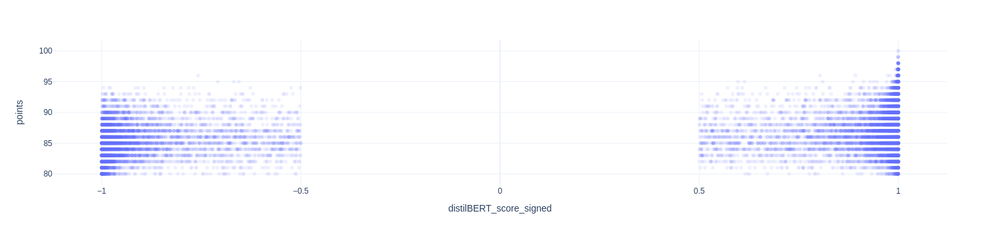

In [3]:
px.scatter(df_input,
           x = "distilBERT_score_signed",
           y = "points",
           opacity = 0.1,
           width = 500,
           height = 300,
           template = "plotly_white"
          )

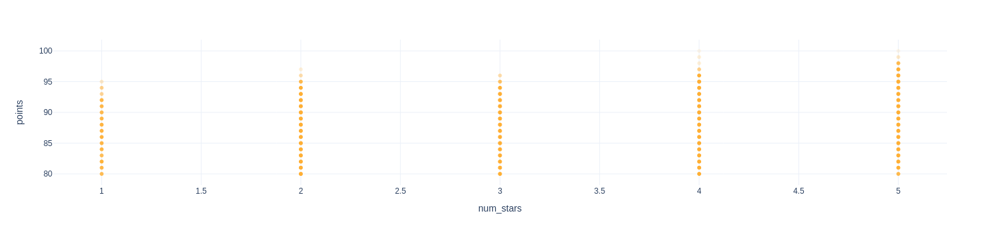

In [4]:
px.scatter(df_input,
           x = "num_stars",
           y = "points",
           opacity = 0.1,
           color_discrete_sequence = ["#FFAF33"],
           width = 500,
           height = 300,
           template = "plotly_white"
          )

In [5]:
df_input.corr()["points"]

<ipython-input-5-bda26728a388>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



price                      0.547068
points                     1.000000
pos_word_count            -0.005608
neg_word_prop              0.002762
distilBERT_score_signed    0.327659
num_stars                  0.397876
Name: points, dtype: float64

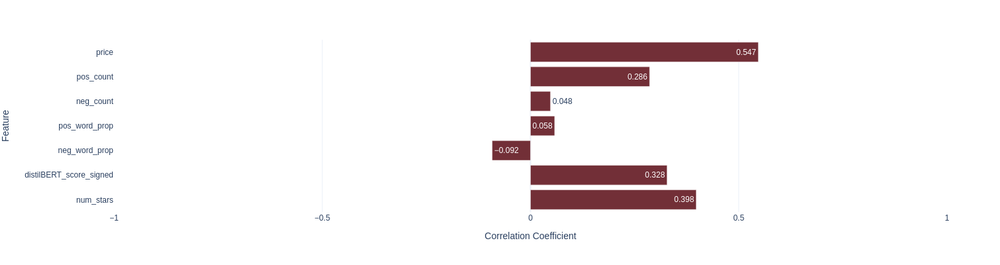

In [6]:
import plotly.express as px

pos_neg_corr_dict = {"Feature": ["price", "pos_count", "neg_count", "pos_word_prop", "neg_word_prop", "distilBERT_score_signed", "num_stars"],
                     "Correlation Coefficient": [0.547, 0.286, 0.048, 0.058, -0.092, 0.328, 0.398]
                    }

corr_df = pd.DataFrame(pos_neg_corr_dict)

px.bar(corr_df,
       y="Feature",
       x="Correlation Coefficient",
       range_x = [-1, 1],
       template="plotly_white",
       category_orders = {"Feature": ["price", "pos_count", "neg_count", "pos_word_prop", "neg_word_prop", "distilBERT_score_signed", "num_stars"]},
       color_discrete_sequence = ["#722F37"],
       width=600,
       height=400,
       text_auto=True
      )

## `log_price_by_stars` feature

In [7]:
df_input["log_price_by_stars"] = np.log1p(df_input["price"] * df_input["num_stars"])
df_input

,country,price,taster_name,points,description,variety,price_cat,pos_word_count,neg_word_prop,distilBERT_score_signed,num_stars,log_price_by_stars
0,Portugal,15.0,Roger Voss,87,"This is ripe and fruity, a wine that is smooth...",Portuguese Red,0-20,NaN,NaN,0.999641,4,4.110874
1,US,14.0,Paul Gregutt,87,"Tart and snappy, the flavors of lime flesh and...",Pinot Gris,0-20,2.0,0.000000,0.995343,4,4.043051
2,US,13.0,Alexander Peartree,87,"Pineapple rind, lemon pith and orange blossom ...",Riesling,0-20,4.0,0.000000,0.985368,3,3.688879
3,US,65.0,Paul Gregutt,87,"Much like the regular bottling from 2012, this...",Pinot Noir,60-80,2.0,0.045455,0.999289,3,5.278115
4,Spain,15.0,Michael Schachner,87,Blackberry and raspberry aromas show a typical...,Other,0-20,3.0,0.095238,0.999074,4,4.110874
...,...,...,...,...,...,...,...,...,...,...,...,...
117019,Germany,28.0,Anna Lee C. Iijima,90,Notes of honeysuckle and cantaloupe sweeten th...,Riesling,20-40,2.0,0.125000,0.999781,5,4.948760
117020,US,75.0,Paul Gregutt,90,Citation is given as much as a decade of bottl...,Pinot Noir,60-80,1.0,0.142857,0.999588,4,5.707110
117021,France,30.0,Roger Voss,90,Well-drained gravel soil gives this wine its c...,Gewürztraminer,20-40,1.0,0.200000,0.998903,3,4.510860
117022,France,32.0,Roger Voss,90,"A dry style of Pinot Gris, this is crisp with ...",Pinot Gris,20-40,1.0,0.083333,0.999602,4,4.859812


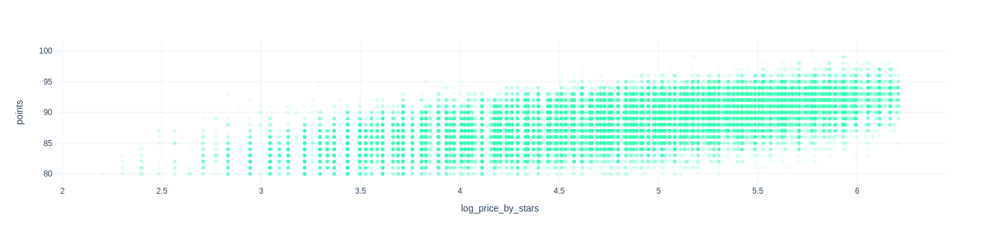

In [8]:
px.scatter(df_input,
           x = "log_price_by_stars",
           y = "points",
           opacity = 0.1,
           color_discrete_sequence = ["#33FFAF"],
           width = 500,
           height = 300,
           template = "plotly_white"
          )

In [9]:
df_input.corr()["points"]

<ipython-input-9-bda26728a388>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



price                      0.547068
points                     1.000000
pos_word_count            -0.005608
neg_word_prop              0.002762
distilBERT_score_signed    0.327659
num_stars                  0.397876
log_price_by_stars         0.658502
Name: points, dtype: float64

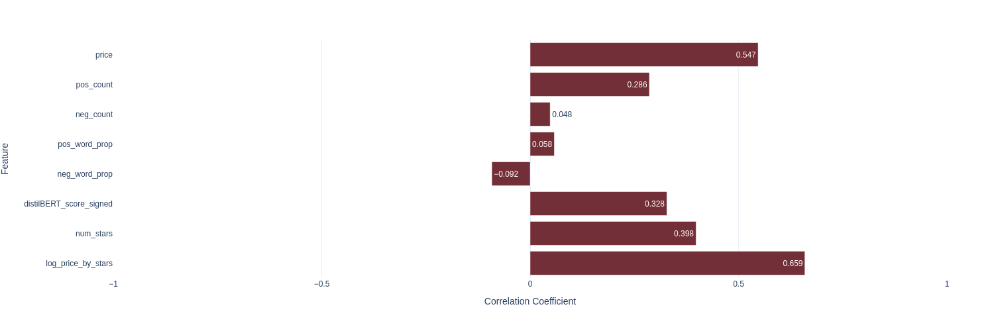

In [10]:
import plotly.express as px

pos_neg_corr_dict = {"Feature": ["price", "pos_count", "neg_count", "pos_word_prop", "neg_word_prop", "distilBERT_score_signed", "num_stars", "log_price_by_stars"],
                     "Correlation Coefficient": [0.547, 0.286, 0.048, 0.058, -0.092, 0.328, 0.398, 0.659]
                    }

corr_df = pd.DataFrame(pos_neg_corr_dict)

px.bar(corr_df,
       y="Feature",
       x="Correlation Coefficient",
       range_x = [-1, 1],
       template="plotly_white",
       category_orders = {"Feature": ["price", "pos_count", "neg_count", "pos_word_prop", "neg_word_prop", "distilBERT_score_signed", "num_stars", "log_price_by_stars"]},
       color_discrete_sequence = ["#722F37"],
       width=600,
       height=500,
       text_auto=True
      )

## Split data

In [11]:
from sklearn.model_selection import train_test_split
strat_train_set, strat_test_set = train_test_split(df_input,
                                                   test_size=0.2,
                                                   random_state=42,
                                                   stratify = df_input["price_cat"])

In [12]:
reviews = strat_train_set.drop("points", axis=1)
reviews_labels = strat_train_set["points"].copy()

In [13]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93619 entries, 45847 to 112606
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   country                  93575 non-null  object  
 1   price                    93619 non-null  float64 
 2   taster_name              74764 non-null  object  
 3   description              93619 non-null  object  
 4   variety                  93618 non-null  object  
 5   price_cat                93619 non-null  category
 6   pos_word_count           84335 non-null  float64 
 7   neg_word_prop            84335 non-null  float64 
 8   distilBERT_score_signed  93619 non-null  float64 
 9   num_stars                93619 non-null  int64   
 10  log_price_by_stars       93619 non-null  float64 
dtypes: category(1), float64(5), int64(1), object(4)
memory usage: 7.9+ MB


## Linear Regression with Different NLP Feature Combinations

### + `distilBERT_score_signed`

In [66]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

# Numerical pipeline
reviews_num = reviews.loc[:, [
                              "price", 
                              "pos_word_count", "neg_word_prop", 
                              "distilBERT_score_signed",
                              # "num_stars",
                              # "log_price_by_stars"
                             ]
                         ]

num_attribs = list(reviews_num)

## List numerical and categorical attributes
cat_attribs = [
               "country",
               "taster_name",
               "variety"
              ]

# Full pipeline
full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])


reviews_prepared = full_pipeline.fit_transform(reviews)


from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()

from sklearn.model_selection import cross_val_score

# 10-fold cross-validation
scores = cross_val_score(lin_reg, 
                         reviews_prepared, 
                         reviews_labels,
                         scoring="neg_mean_squared_error",
                         n_jobs=4,
                         cv=10)
# convert to RMSE
lin_reg_scores = np.sqrt(-scores)
print(f"Mean RMSE from + distilBERT_score_signed: {lin_reg_scores.mean(): .2f}")

Mean RMSE from + distilBERT_score_signed:  2.17


### + `num_stars`

In [67]:
# Numerical pipeline
reviews_num = reviews.loc[:, [
                              "price", 
                              "pos_word_count", "neg_word_prop", 
                              # "distilBERT_score_signed",
                              "num_stars",
                              # "log_price_by_stars"
                             ]
                         ]

num_attribs = list(reviews_num)

## List numerical and categorical attributes
cat_attribs = [
               "country",
               "taster_name",
               "variety"
              ]

# Full pipeline
full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])


reviews_prepared = full_pipeline.fit_transform(reviews)


from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()

from sklearn.model_selection import cross_val_score

# 10-fold cross-validation
scores = cross_val_score(lin_reg, 
                         reviews_prepared, 
                         reviews_labels,
                         scoring="neg_mean_squared_error",
                         n_jobs=4,
                         cv=10)
# convert to RMSE
lin_reg_scores = np.sqrt(-scores)
print(f"Mean RMSE from + num_stars: {lin_reg_scores.mean(): .2f}")

Mean RMSE from + num_stars:  2.12


### `"log_price_by_stars` and all others

In [68]:
# Numerical pipeline
reviews_num = reviews.loc[:, [
                              "price", 
                              "pos_word_count", "neg_word_prop", 
                              "distilBERT_score_signed",
                              "num_stars",
                              "log_price_by_stars"
                             ]
                         ]

num_attribs = list(reviews_num)

## List numerical and categorical attributes
cat_attribs = [
               "country",
               "taster_name",
               "variety"
              ]

# Full pipeline
full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])


reviews_prepared = full_pipeline.fit_transform(reviews)


from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()

from sklearn.model_selection import cross_val_score

# 10-fold cross-validation
scores = cross_val_score(lin_reg, 
                         reviews_prepared, 
                         reviews_labels,
                         scoring="neg_mean_squared_error",
                         n_jobs=4,
                         cv=10)
# convert to RMSE
lin_reg_scores = np.sqrt(-scores)
print(f"Mean RMSE from + num_stars: {lin_reg_scores.mean(): .2f}")

Mean RMSE from + num_stars:  2.02


### RMSE Plot for Linear Regression and NLP Features

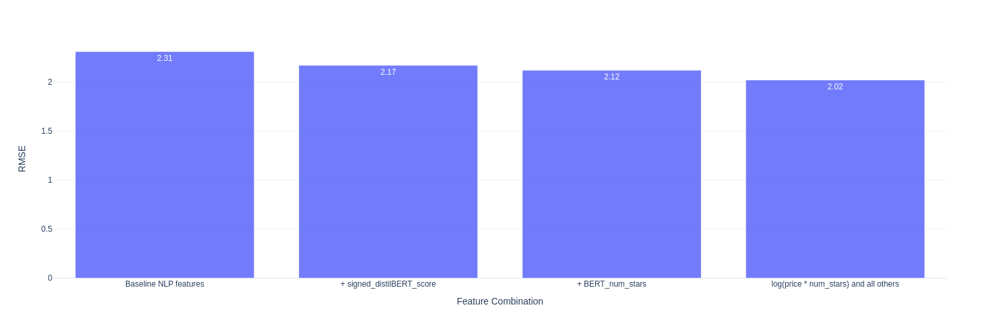

In [71]:
lin_reg_features_RMSEs_dict = {"Feature Combination": ["Baseline NLP features", 
                                                       "+ signed_distilBERT_score",
                                                       "+ BERT_num_stars", 
                                                       "log(price * num_stars) and all others"],
                               
                               "RMSE": [2.31, 
                                        2.17, 
                                        2.12, 
                                        2.02]
                              }

px.bar(pd.DataFrame(lin_reg_features_RMSEs_dict),
       x = "Feature Combination",
       y = "RMSE",
       # title = "Linear Regression (unoptimized) RMSEs from Different Feature Combinations",
       opacity = 0.9,
       template = "plotly_white",
       width = 700,
       height = 500,
       text_auto=True
      )

## Pipeline (actual)

In [15]:
# 7) Build pipeline
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder


# Numerical pipeline
reviews_num = reviews.loc[:, [
                              "price", 
                              "pos_word_count", "neg_word_prop", 
                              "distilBERT_score_signed",
                              "num_stars",
                              "log_price_by_stars"
                             ]
                         ]

num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('std_scaler', StandardScaler()),
    ])

## List numerical and categorical attributes
num_attribs = list(reviews_num)
cat_attribs = [
               "country",
               "taster_name",
               "variety"
              ]

# Full pipeline
full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])

reviews_prepared = full_pipeline.fit_transform(reviews)
reviews_prepared

<93619x271 sparse matrix of type '<class 'numpy.float64'>'
	with 842571 stored elements in Compressed Sparse Row format>

## Model Selection and Tuning

### SGDRegressor

#### Tuning

In [72]:
from sklearn.linear_model import SGDRegressor
from sklearn.model_selection import GridSearchCV


import timeit
start_time = timeit.default_timer()

param_grid = [
    {"penalty": ["l2", "l1", "elasticnet"],
     "alpha": [0.0001, 0.001, 0.01, 0.1, 1, 10],
     "learning_rate": ["invscaling", "constant", "optimal"]
    }
]

lin_reg_SGD = SGDRegressor(random_state=42)

grid_search = GridSearchCV(lin_reg_SGD,
                           param_grid,
                           cv=5,
                           scoring="neg_mean_squared_error",
                           n_jobs=5)

grid_search.fit(reviews_prepared, reviews_labels)


elapsed = timeit.default_timer() - start_time
print("Elapsed time: {} minutes".format(elapsed/60))

Elapsed time: 6.020552365599997 minutes


In [73]:
grid_search.best_params_

{'alpha': 0.001, 'learning_rate': 'constant', 'penalty': 'elasticnet'}

In [16]:
from sklearn.linear_model import SGDRegressor

lin_reg_SGD_optimized = SGDRegressor(random_state=42,
                                    alpha = 0.001,
                                    learning_rate = "constant",
                                    penalty = "elasticnet")

from sklearn.model_selection import cross_val_score

# 10-fold cross-validation
scores = cross_val_score(lin_reg_SGD_optimized, 
                         reviews_prepared, 
                         reviews_labels,
                         scoring="neg_mean_squared_error",
                         n_jobs=4,
                         cv=10)
# convert to RMSE
lin_reg_SGD_scores_optimal = np.sqrt(-scores)
print(f"Mean RMSE from optimized linear SGD: {lin_reg_SGD_scores_optimal.mean(): .2f}")

Mean RMSE from optimized linear SGD:  2.06


In [ ]:
lin_reg_SGD_scores_optimal.std()

### SVM

#### Smaller Dataset to lower tuning time

In [83]:
# Split data
strat_train_set_abbrev, strat_test_set_abbrev = train_test_split(df_input.sample(40000, random_state=42),
                                                                 test_size=0.2,
                                                                 random_state=42,
                                                                 stratify = df_input.sample(40000, random_state=42)["price_cat"])

reviews_abbrev = strat_train_set_abbrev.drop("points", axis=1)
reviews_labels_abbrev = strat_train_set_abbrev["points"].copy()



# Full pipeline
full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])

reviews_prepared_abbrev = full_pipeline.fit_transform(reviews_abbrev)
reviews_prepared_abbrev

<32000x271 sparse matrix of type '<class 'numpy.float64'>'
	with 288000 stored elements in Compressed Sparse Row format>

#### Tuning

In [84]:
# GridSearch Cross Validation
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV

import timeit
start_time = timeit.default_timer()

param_grid = [
    {"C": [0.01, 0.1, 1, 10],
     "kernel": ["rbf", "linear", "poly"],
     "degree": [2, 3, 4]
    }
]

svm_reg = SVR()

grid_search = GridSearchCV(svm_reg,
                           param_grid,
                           cv=5,
                           scoring="neg_mean_squared_error",
                           n_jobs=5)

grid_search.fit(reviews_prepared_abbrev, reviews_labels_abbrev)


elapsed = timeit.default_timer() - start_time
print("Elapsed time: {} minutes".format(elapsed/60))

Elapsed time: 47.04808272713332 minutes


In [85]:
grid_search.best_params_

{'C': 1, 'degree': 2, 'kernel': 'rbf'}

In [32]:
from sklearn.svm import SVR

svm_reg_tuned = SVR(C = 1,
                   degree = 2, # understood doesn't do anything without kernel="poly" but keeping anyway for consistency
                   kernel = "rbf",
                   )


# CV
from sklearn.model_selection import cross_val_score

import timeit
start_time = timeit.default_timer()

# 10-fold cross-validation
scores_svm_tuned = cross_val_score(svm_reg_tuned, 
                                   reviews_prepared,
                                   reviews_labels,
                                   scoring="neg_mean_squared_error",
                                   n_jobs=5,
                                   cv=5)

elapsed = timeit.default_timer() - start_time
print("Elapsed time: {} minutes".format(elapsed/60))

# convert to RMSE
svm_reg_scores_tuned = np.sqrt(-scores_svm_tuned)
print(f"Mean RMSE from optimized SVM: {svm_reg_scores_tuned.mean(): .2f}")

Elapsed time: 7.151140858733348 minutes
Mean RMSE from optimized SVM:  1.93


In [87]:
svm_reg_scores_tuned.std()

0.008858062981138263

### Neural Network

In [17]:
import tensorflow as tf
from tensorflow import keras

In [18]:
reviews_prepared.shape[1:]

(271,)

In [19]:
model = keras.models.Sequential([
    keras.layers.Dense(50,
                       activation="relu",
                       input_shape=reviews_prepared.shape[1:]),

    keras.layers.Dense(1)
])

In [20]:
reviews_labels.to_numpy()

array([86, 90, 89, ..., 97, 86, 86])

In [21]:
model.compile(loss="mean_squared_error",
              optimizer=keras.optimizers.SGD(lr=0.001)
              # optimizer="nadam"
             )

model_trained = model.fit(reviews_prepared, 
                          reviews_labels.to_numpy(),
                          epochs=10
                         )

Epoch 1/10


/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/gradient_descent.py:111: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning:

Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Reshape:0", shape=(None, 50), dtype=float32), dense_shape=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.



2926/2926 [==============================] - 12s 4ms/step - loss: 39.8929
Epoch 2/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.1969
Epoch 3/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.1160
Epoch 4/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.0897
Epoch 5/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.0608
Epoch 6/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.0470
Epoch 7/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.0282
Epoch 8/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.0155
Epoch 9/10
2926/2926 [==============================] - 11s 4ms/step - loss: 4.0091
Epoch 10/10
2926/2926 [==============================] - 11s 4ms/step - loss: 3.9978


In [22]:
np.sqrt(model_trained.history["loss"][-1])

1.9994618168566938

In [23]:
model_trained.history["loss"]

[39.89292526245117,
 4.196867942810059,
 4.1159796714782715,
 4.089675426483154,
 4.060829162597656,
 4.046957492828369,
 4.028190612792969,
 4.015462875366211,
 4.009121894836426,
 3.997847557067871]

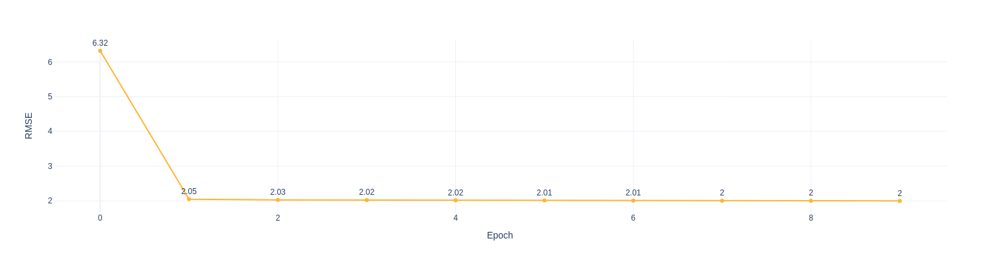

In [25]:
neural_performance_df = pd.DataFrame({"Epoch": [i for i in range(10)],
                                      "RMSE": list(np.sqrt(np.array(model_trained.history["loss"])))
                                     }
                                    )
fig = px.line(neural_performance_df,
        x="Epoch",
        y="RMSE",
              # title = "10 epochs, 50 neurons",
        markers=True,
        width=600,
        height=400,
        template="plotly_white",
                  color_discrete_sequence = ["#FFB533"],
        text = np.round(np.sqrt(np.array(model_trained.history["loss"])), 2)
       )

fig.update_traces(textposition='top center')

#### Tuning

##### 1HL, 50 neurons, 10 epochs, linear activation function

In [42]:
model = keras.models.Sequential([
    keras.layers.Dense(50,
                       activation="linear",
                       input_shape=reviews_prepared.shape[1:]),

    keras.layers.Dense(1)
])


model.compile(loss="mean_squared_error",
              optimizer=keras.optimizers.SGD(lr=0.001)
             )

model_trained = model.fit(reviews_prepared, 
                          reviews_labels.to_numpy(),
                          epochs=10
                         )

np.sqrt(model_trained.history["loss"][-1])

Epoch 1/10


/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/gradient_descent.py:111: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning:

Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_1/dense_2/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_1/dense_2/embedding_lookup_sparse/Reshape:0", shape=(None, 50), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_1/dense_2/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.



2926/2926 [==============================] - 13s 4ms/step - loss: 34.0710
Epoch 2/10
2926/2926 [==============================] - 12s 4ms/step - loss: 4.2775
Epoch 3/10
2926/2926 [==============================] - 12s 4ms/step - loss: 4.2428
Epoch 4/10
2926/2926 [==============================] - 12s 4ms/step - loss: 4.2337
Epoch 5/10
2926/2926 [==============================] - 12s 4ms/step - loss: 4.2283
Epoch 6/10
2926/2926 [==============================] - 12s 4ms/step - loss: 4.2229
Epoch 7/10
2926/2926 [==============================] - 13s 4ms/step - loss: 4.2234
Epoch 8/10
2926/2926 [==============================] - 13s 4ms/step - loss: 4.2110
Epoch 9/10
2926/2926 [==============================] - 13s 4ms/step - loss: 4.2149
Epoch 10/10
2926/2926 [==============================] - 12s 4ms/step - loss: 4.2127


2.052487083515223

##### 1 HL, 200 neurons, 10 epochs

In [43]:
model = keras.models.Sequential([
    keras.layers.Dense(200,
                       activation="relu",
                       input_shape=reviews_prepared.shape[1:]),

    keras.layers.Dense(1)
])


model.compile(loss="mean_squared_error",
              optimizer=keras.optimizers.SGD(lr=0.001)
             )

model_trained = model.fit(reviews_prepared, 
                          reviews_labels.to_numpy(),
                          epochs=10
                         )

Epoch 1/10


/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning:

Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_2/dense_4/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_2/dense_4/embedding_lookup_sparse/Reshape:0", shape=(None, 200), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_2/dense_4/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.



2926/2926 [==============================] - 13s 4ms/step - loss: 37.7679
Epoch 2/10
2926/2926 [==============================] - 13s 4ms/step - loss: 4.1457
Epoch 3/10
2926/2926 [==============================] - 13s 4ms/step - loss: 4.0686
Epoch 4/10
2926/2926 [==============================] - 13s 4ms/step - loss: 4.0303
Epoch 5/10
2926/2926 [==============================] - 13s 4ms/step - loss: 3.9939
Epoch 6/10
2926/2926 [==============================] - 13s 4ms/step - loss: 3.9761
Epoch 7/10
2926/2926 [==============================] - 13s 4ms/step - loss: 3.9611
Epoch 8/10
2926/2926 [==============================] - 13s 4ms/step - loss: 3.9419
Epoch 9/10
2926/2926 [==============================] - 15s 5ms/step - loss: 3.9303
Epoch 10/10
2926/2926 [==============================] - 15s 5ms/step - loss: 3.9255


In [44]:
np.sqrt(model_trained.history["loss"][-1])

1.9812861153472812

##### 1 HL, 20 neurons, 10 epochs

In [45]:
model = keras.models.Sequential([
    keras.layers.Dense(20,
                       activation="relu",
                       input_shape=reviews_prepared.shape[1:]),

    keras.layers.Dense(1)
])


model.compile(loss="mean_squared_error",
              optimizer=keras.optimizers.SGD(lr=0.001)
             )

model_trained = model.fit(reviews_prepared, 
                          reviews_labels.to_numpy(),
                          epochs=10
                         )

np.sqrt(model_trained.history["loss"][-1])

Epoch 1/10


/home/ajpalec/anaconda3/envs/dsci_631/lib/python3.9/site-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning:

Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_3/dense_6/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_3/dense_6/embedding_lookup_sparse/Reshape:0", shape=(None, 20), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_3/dense_6/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.



2926/2926 [==============================] - 16s 5ms/step - loss: 39.6395
Epoch 2/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.2323
Epoch 3/10
2926/2926 [==============================] - 14s 5ms/step - loss: 4.1671
Epoch 4/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.1352
Epoch 5/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.1054
Epoch 6/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.0862
Epoch 7/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.0666
Epoch 8/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.0556
Epoch 9/10
2926/2926 [==============================] - 16s 5ms/step - loss: 4.0387
Epoch 10/10
2926/2926 [==============================] - 15s 5ms/step - loss: 4.0202


2.0050340717112873

#### Best model is: 1 HL, 50 neurons, relu activation function, 10 epochs
* Testing with 200 neurons did not generalize well to test set.

### Model RMSE Comparison

In [38]:
for RMSE in [lin_reg_SGD_scores_optimal.mean(), svm_reg_scores_tuned.mean(), np.sqrt(model_trained.history["loss"][-1])]:
    print(RMSE)

2.0552241834770504
1.9342002322292131
1.9994618168566938


In [39]:
for std in [lin_reg_SGD_scores_optimal.std(), svm_reg_scores_tuned.std(), np.nan]:
    print(std)

0.02420943530415104
0.008858062981138263
nan


#### Mean scores -

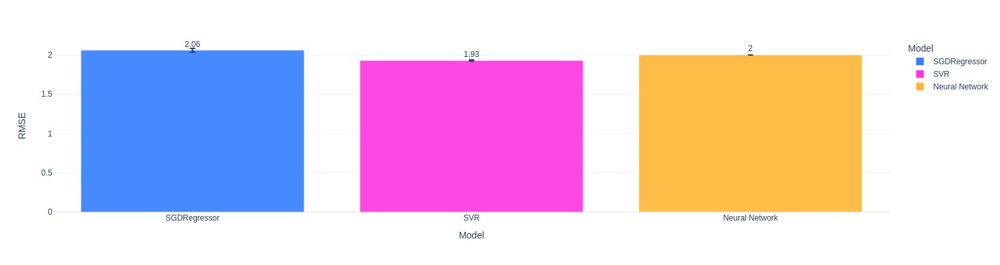

In [40]:
model_RMSEs = pd.DataFrame({"Model": ["SGDRegressor", "SVR", "Neural Network"],
                            "RMSE": [2.06, 1.93, 2.00],
                            "std": [0.024, 0.009, np.nan]
              })


fig = px.bar(model_RMSEs,
       x = "Model",
       y = "RMSE",
       error_y = "std",
       opacity = 0.9,
       color = "Model",
       color_discrete_sequence = ["#337DFF", "#FF33E3", "#FFB533"],
       template = "plotly_white",
       width = 600,
       height = 400,
       text_auto=True,
      )

fig.update_traces(textposition='outside',  texttemplate= "%{value: .2%f}")

# Test Set Performance

In [26]:
# 7) Build pipeline
reviews_test = strat_test_set.drop("points", axis=1)
reviews_test_labels = strat_test_set["points"].copy()


# from sklearn.pipeline import Pipeline
# from sklearn.impute import SimpleImputer
# from sklearn.preprocessing import StandardScaler
# from sklearn.compose import ColumnTransformer
# from sklearn.preprocessing import OneHotEncoder


reviews_prepared_test = full_pipeline.transform(reviews_test)
reviews_prepared_test

<23405x271 sparse matrix of type '<class 'numpy.float64'>'
	with 210645 stored elements in Compressed Sparse Row format>

## SGDRegressor

In [27]:
from sklearn.linear_model import SGDRegressor

# Instantiate model
lin_reg_SGD_optimized = SGDRegressor(random_state=42,
                                    alpha = 0.001,
                                    learning_rate = "constant",
                                    penalty = "elasticnet")

# Fit to training data
lin_reg_SGD_optimized.fit(reviews_prepared,
                          reviews_labels)

# Predict on test set
lin_reg_SGD_predictions = lin_reg_SGD_optimized.predict(reviews_prepared_test)


# Calculate RMSE 
from sklearn.metrics import mean_squared_error
lin_reg_SGD_mse = mean_squared_error(reviews_test_labels.to_numpy(), 
                                     lin_reg_SGD_predictions)
lin_reg_SGD_rmse = np.sqrt(lin_reg_SGD_mse)

print(f"RMSE on test set for SGDRegessor: {lin_reg_SGD_rmse: .2f}")

RMSE on test set for SGDRegessor:  2.04


## SVM

In [28]:
from sklearn.svm import SVR

# Instantiate model
svm_reg_tuned = SVR(C = 1,
                    degree = 2, # understood doesn't do anything without kernel="poly" but keeping anyway for consistency
                    kernel = "rbf")

# Fit to training data
svm_reg_tuned.fit(reviews_prepared,
                  reviews_labels)

# Predict on test set
svm_reg_tuned_predictions = svm_reg_tuned.predict(reviews_prepared_test)


# Calculate RMSE 
from sklearn.metrics import mean_squared_error
svm_reg_mse = mean_squared_error(reviews_test_labels.to_numpy(), 
                                 svm_reg_tuned_predictions)

svm_reg_rmse = np.sqrt(svm_reg_mse)

print(f"RMSE on test set for SVR: {svm_reg_rmse: .2f}")

RMSE on test set for SVR:  1.91


## Neural Network

In [29]:
mse_test = model.evaluate(reviews_prepared_test, reviews_test_labels.to_numpy())

np.sqrt(mse_test)

732/732 [==============================] - 2s 3ms/step - loss: 4.0480


2.0119602688000526

## Visualization

In [ ]:
model_RMSEs = pd.DataFrame({"Model": ["SGDRegressor", "SVR", "Neural Network"],
                            "RMSE": [2.06, 1.93, 2.00],
                            "std": [0.024, 0.009, np.nan]
              })


fig = px.bar(model_RMSEs,
       x = "Model",
       y = "RMSE",
       error_y = "std",
       opacity = 0.9,
       color = "Model",
       color_discrete_sequence = ["#337DFF", "#FF33E3", "#FFB533"],
       template = "plotly_white",
       width = 600,
       height = 400,
       text_auto=True,
      )

fig.update_traces(textposition='outside',  texttemplate= "%{value: .2%f}")

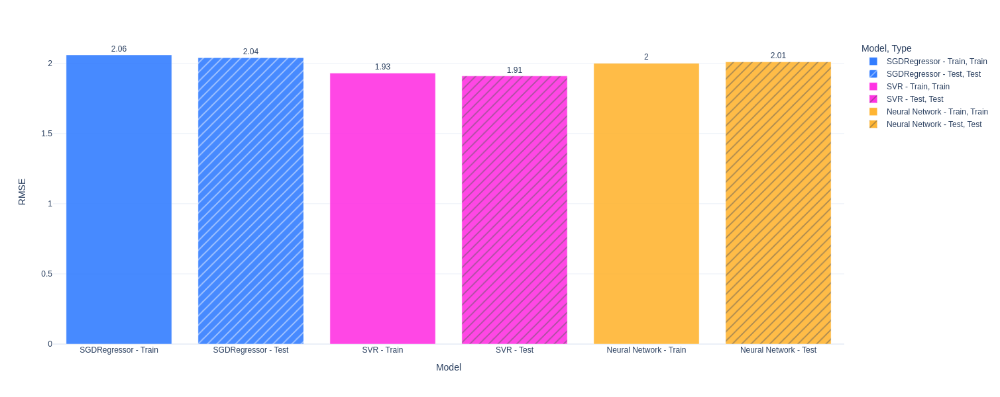

In [41]:
test_RMSEs = pd.DataFrame({"Model": ["SGDRegressor - Train", "SGDRegressor - Test",
                                     "SVR - Train", "SVR - Test",
                                     "Neural Network - Train", "Neural Network - Test"],
                           "RMSE": [2.06, 2.04, 1.93, 1.91, 2.00, 2.01], 
                           "Type": ["Train", "Test", "Train", "Test", "Train", "Test"]
                           
              })



fig = px.bar(test_RMSEs,
       x = "Model",
       y = "RMSE",
       pattern_shape = "Type",
       opacity = 0.9,
       color = "Model",
       color_discrete_sequence = ["#337DFF", "#337DFF", "#FF33E3", "#FF33E3", "#FFB533", "#FFB533"],
       pattern_shape_sequence=["", "/", "" ,"/", "", "/"],
       template = "plotly_white",
       # barmode="group",
       width = 1000,
       height = 600,
       text_auto=True,
      )

fig.update_traces(textposition='outside',  texttemplate= "%{value: .1%f}")

### SVR appears to be the best performing mode technically, though all are comparable.
### In practice (in industry...) would likely implement the simple linear model due to efficiencies and interpretability